<a href="https://colab.research.google.com/github/ShreyaPalak/Smart-Shelf-Management/blob/main/TRAINED%20YOLO%20MODEL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [15]:
from google.colab import files
uploaded = files.upload()

Saving data.zip to data.zip


In [16]:
!unzip data.zip


Archive:  data.zip
   creating: Supermarket shelves/
   creating: Supermarket shelves/Supermarket shelves/
   creating: Supermarket shelves/Supermarket shelves/annotations/
  inflating: Supermarket shelves/Supermarket shelves/annotations/001.jpg.json  
  inflating: Supermarket shelves/Supermarket shelves/annotations/002.jpg.json  
  inflating: Supermarket shelves/Supermarket shelves/annotations/003.jpg.json  
  inflating: Supermarket shelves/Supermarket shelves/annotations/004.jpg.json  
  inflating: Supermarket shelves/Supermarket shelves/annotations/005.jpg.json  
  inflating: Supermarket shelves/Supermarket shelves/annotations/006.jpg.json  
  inflating: Supermarket shelves/Supermarket shelves/annotations/007.jpg.json  
  inflating: Supermarket shelves/Supermarket shelves/annotations/008.jpg.json  
  inflating: Supermarket shelves/Supermarket shelves/annotations/009.jpg.json  
  inflating: Supermarket shelves/Supermarket shelves/annotations/010.jpg.json  
  inflating: Supermarket sh

In [14]:
!ls -R "Supermarket shelves"


ls: cannot access 'Supermarket shelves': No such file or directory


In [11]:
!ls -R "Supermarket shelves"


ls: cannot access 'Supermarket shelves': No such file or directory


In [17]:
import json
import glob

annotation_files = glob.glob("Supermarket shelves/Supermarket shelves/annotations/*.json")

total_objects = 0

for file in annotation_files:
    with open(file) as f:
        data = json.load(f)
        total_objects += len(data["objects"])  # usually objects stored here

print("Total images:", len(annotation_files))
print("Total objects in dataset:", total_objects)


Total images: 45
Total objects in dataset: 11743


In [18]:
from collections import Counter

sku_counter = Counter()

for file in annotation_files:
    with open(file) as f:
        data = json.load(f)

        for obj in data["objects"]:
            sku_name = obj["classTitle"]   # usually SKU name stored here
            sku_counter[sku_name] += 1

print("Number of unique SKUs:", len(sku_counter))
print("\nTop 10 SKUs:")
for sku, count in sku_counter.most_common(10):
    print(sku, ":", count)


Number of unique SKUs: 2

Top 10 SKUs:
Product : 9967
Price : 1776


In [19]:
!pip install ultralytics
from ultralytics import YOLO


In [20]:
import os
import json
import glob

# Paths
base_path = "Supermarket shelves/Supermarket shelves"
images_path = os.path.join(base_path, "images")
annotations_path = os.path.join(base_path, "annotations")

# Create YOLO folders
os.makedirs("dataset/images/train", exist_ok=True)
os.makedirs("dataset/labels/train", exist_ok=True)

class_map = {
    "Product": 0,
    "Price": 1
}

annotation_files = glob.glob(annotations_path + "/*.json")

for ann_file in annotation_files:
    with open(ann_file) as f:
        data = json.load(f)

    image_name = data["description"]
    image_width = data["size"]["width"]
    image_height = data["size"]["height"]

    yolo_labels = []

    for obj in data["objects"]:
        class_name = obj["classTitle"]
        if class_name not in class_map:
            continue

        bbox = obj["points"]["exterior"]
        x1, y1 = bbox[0]
        x2, y2 = bbox[1]

        # Convert to YOLO format
        x_center = ((x1 + x2) / 2) / image_width
        y_center = ((y1 + y2) / 2) / image_height
        width = abs(x2 - x1) / image_width
        height = abs(y2 - y1) / image_height

        yolo_labels.append(f"{class_map[class_name]} {x_center} {y_center} {width} {height}")

    # Save label file
    label_filename = os.path.basename(ann_file).replace(".json", ".txt")
    with open(f"dataset/labels/train/{label_filename}", "w") as f:
        f.write("\n".join(yolo_labels))

    # Copy image
    os.system(f'cp "{images_path}/{image_name}" dataset/images/train/')


In [21]:
import os
import glob
import random
import shutil

# Create val folders
os.makedirs("dataset/images/val", exist_ok=True)
os.makedirs("dataset/labels/val", exist_ok=True)

images = glob.glob("dataset/images/train/*.jpg")

random.shuffle(images)

split_index = int(len(images) * 0.8)
train_images = images[:split_index]
val_images = images[split_index:]

for img_path in val_images:
    filename = os.path.basename(img_path)

    # Move image
    shutil.move(img_path, f"dataset/images/val/{filename}")

    # Move label
    label_file = filename.replace(".jpg", ".txt")
    shutil.move(f"dataset/labels/train/{label_file}",
                f"dataset/labels/val/{label_file}")

print("Train images:", len(train_images))
print("Val images:", len(val_images))


Train images: 0
Val images: 0


In [22]:
!rm -rf dataset


In [23]:
!ls

 data.zip   sample_data  'Supermarket shelves'


In [24]:
!ls "Supermarket shelves/Supermarket shelves/images" | wc -l


45


In [25]:
import os
import json
import glob
import shutil

# Correct base path
base_path = "Supermarket shelves/Supermarket shelves"
images_path = os.path.join(base_path, "images")
annotations_path = os.path.join(base_path, "annotations")

# Create YOLO folder structure
os.makedirs("dataset/images/train", exist_ok=True)
os.makedirs("dataset/labels/train", exist_ok=True)

class_map = {
    "Product": 0,
    "Price": 1
}

annotation_files = glob.glob(annotations_path + "/*.json")

for ann_file in annotation_files:
    with open(ann_file) as f:
        data = json.load(f)

    # Get image filename from JSON filename instead
    image_filename = os.path.basename(ann_file).replace(".json", "")
    image_width = data["size"]["width"]
    image_height = data["size"]["height"]

    yolo_labels = []

    for obj in data["objects"]:
        class_name = obj["classTitle"]
        if class_name not in class_map:
            continue

        bbox = obj["points"]["exterior"]
        x1, y1 = bbox[0]
        x2, y2 = bbox[1]

        x_center = ((x1 + x2) / 2) / image_width
        y_center = ((y1 + y2) / 2) / image_height
        width = abs(x2 - x1) / image_width
        height = abs(y2 - y1) / image_height

        yolo_labels.append(
            f"{class_map[class_name]} {x_center} {y_center} {width} {height}"
        )

    # Save label file
    label_filename = image_filename.replace(".jpg", ".txt")
    with open(f"dataset/labels/train/{label_filename}", "w") as f:
        f.write("\n".join(yolo_labels))

    # Copy image correctly
    shutil.copy(
        os.path.join(images_path, image_filename),
        os.path.join("dataset/images/train", image_filename)
    )

print("Conversion completed.")


Conversion completed.


In [26]:
!ls dataset/images/train | wc -l


45


In [27]:
import random
import glob
import shutil

os.makedirs("dataset/images/val", exist_ok=True)
os.makedirs("dataset/labels/val", exist_ok=True)

images = glob.glob("dataset/images/train/*.jpg")
random.shuffle(images)

split_index = int(len(images) * 0.8)
val_images = images[split_index:]

for img_path in val_images:
    filename = os.path.basename(img_path)
    shutil.copy(img_path, f"dataset/images/val/{filename}")
    shutil.copy(
        f"dataset/labels/train/{filename.replace('.jpg','.txt')}",
        f"dataset/labels/val/{filename.replace('.jpg','.txt')}"
    )

print("Train images:", len(glob.glob("dataset/images/train/*.jpg")))
print("Val images:", len(glob.glob("dataset/images/val/*.jpg")))


Train images: 45
Val images: 9


In [28]:
%%writefile dataset/data.yaml
path: dataset

train: images/train
val: images/val

names:
  0: Product
  1: Price


Writing dataset/data.yaml


In [29]:
import torch
print(torch.cuda.is_available())


True


In [30]:
from ultralytics import YOLO

model = YOLO("yolov8n.pt")

model.train(
    data="dataset/data.yaml",
    epochs=30,
    imgsz=640,
    batch=16,
    device=0
)


Ultralytics 8.4.14 🚀 Python-3.12.12 torch-2.9.0+cu128 CUDA:0 (Tesla T4, 14913MiB)
engine/trainer: agnostic_nms=False, amp=True, angle=1.0, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=dataset/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, end2end=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=0.0, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x788100776090>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04804

In [34]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [35]:
/content/runs/detect/train/


NameError: name 'content' is not defined

In [36]:
!ls /content/runs/detect


train


In [37]:
!ls /content/runs/detect/train


args.yaml			 labels.jpg	    train_batch61.jpg
BoxF1_curve.png			 results.csv	    train_batch62.jpg
BoxP_curve.png			 results.png	    val_batch0_labels.jpg
BoxPR_curve.png			 train_batch0.jpg   val_batch0_pred.jpg
BoxR_curve.png			 train_batch1.jpg   weights
confusion_matrix_normalized.png  train_batch2.jpg
confusion_matrix.png		 train_batch60.jpg


In [38]:
!ls /content/runs/detect/train/weights


best.pt  last.pt


In [39]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [40]:
!cp -r /content/runs /content/drive/MyDrive/


In [41]:
from ultralytics import YOLO

model = YOLO("/content/runs/detect/train/weights/best.pt")


In [42]:
results = model("dataset/images/train/001.jpg", conf=0.25, show=True)


WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()


image 1/1 /content/dataset/images/train/001.jpg: 448x640 197 Products, 42.6ms
Speed: 3.1ms preprocess, 42.6ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


In [43]:
boxes = results[0].boxes
classes = boxes.cls.tolist()

product_count = classes.count(0)
price_count = classes.count(1)

print("Detected Products:", product_count)
print("Detected Prices:", price_count)


Detected Products: 197
Detected Prices: 0


In [44]:
import glob

image_files = glob.glob("dataset/images/train/*.jpg")

for img in image_files[:5]:
    results = model(img, conf=0.25)
    classes = results[0].boxes.cls.tolist()

    print(img.split("/")[-1],
          "| Products:", classes.count(0),
          "| Prices:", classes.count(1))



image 1/1 /content/dataset/images/train/034.jpg: 480x640 77 Products, 66.8ms
Speed: 4.0ms preprocess, 66.8ms inference, 2.5ms postprocess per image at shape (1, 3, 480, 640)
034.jpg | Products: 77 | Prices: 0

image 1/1 /content/dataset/images/train/013.jpg: 448x640 133 Products, 7.3ms
Speed: 2.8ms preprocess, 7.3ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
013.jpg | Products: 133 | Prices: 0

image 1/1 /content/dataset/images/train/018.jpg: 640x640 94 Products, 8.2ms
Speed: 3.4ms preprocess, 8.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
018.jpg | Products: 94 | Prices: 0

image 1/1 /content/dataset/images/train/040.jpg: 640x448 62 Products, 40.1ms
Speed: 2.8ms preprocess, 40.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 448)
040.jpg | Products: 62 | Prices: 0

image 1/1 /content/dataset/images/train/041.jpg: 448x640 51 Products, 7.3ms
Speed: 3.1ms preprocess, 7.3ms inference, 1.3ms postprocess per image at shape (1, 3,


image 1/1 /content/dataset/images/train/001.jpg: 448x640 197 Products, 6.9ms
Speed: 3.1ms preprocess, 6.9ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


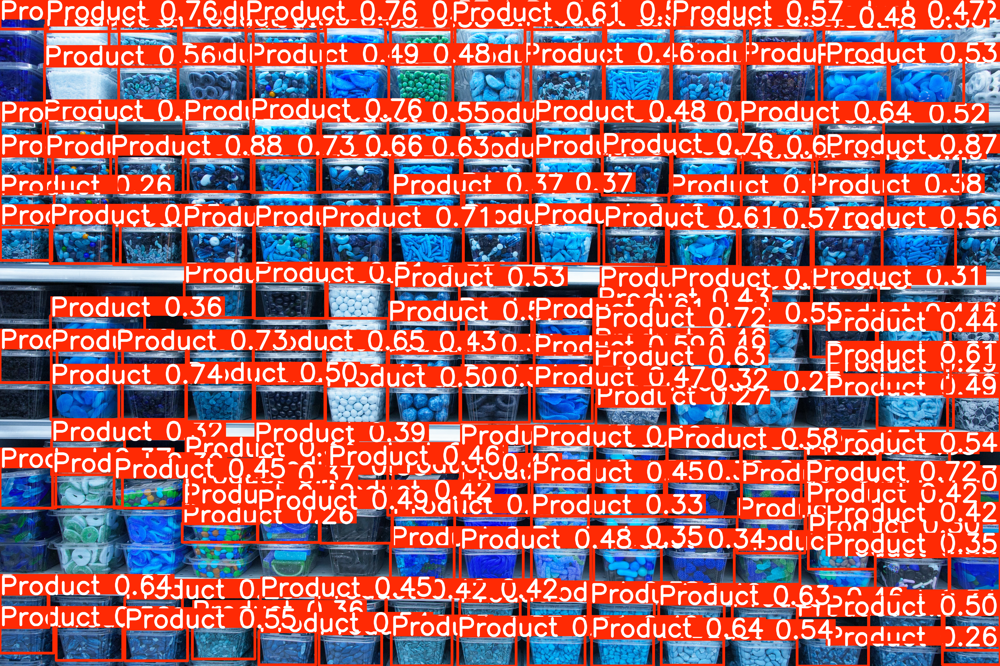

In [45]:
results = model("dataset/images/train/001.jpg", conf=0.25)

from IPython.display import display
from PIL import Image

im_array = results[0].plot()  # draw boxes
im = Image.fromarray(im_array)
display(im)


In [46]:
boxes = results[0].boxes
classes = boxes.cls.tolist()

product_count = classes.count(0)
price_count = classes.count(1)

print("Detected Products:", product_count)
print("Detected Prices:", price_count)


Detected Products: 197
Detected Prices: 0


In [54]:
from google.colab import files
uploaded = files.upload()

Saving iu_5.jpeg to iu_5.jpeg
Saving iu_6.jpeg to iu_6.jpeg
Saving iu_7.jpeg to iu_7.jpeg
Saving iu_8.jpeg to iu_8.jpeg
Saving iu_9.jpeg to iu_9.jpeg
Saving iu_10.jpeg to iu_10.jpeg


In [55]:
from ultralytics import YOLO

model = YOLO("/content/runs/detect/train/weights/best.pt")


In [62]:
from ultralytics import YOLO

# Load your trained model
model = YOLO('/content/runs/detect/train/weights/best.pt')

# Run inference on all jpeg images in /content
results = model.predict(
    source='/content/*.jpeg',  # all uploaded WhatsApp images
    save=True,
    conf=0.25
)


image 1/18 /content/WhatsApp Image 2026-02-16 at 18.49.03.jpeg: 480x640 39 Products, 6.8ms
image 2/18 /content/WhatsApp Image 2026-02-16 at 18.49.06 (1).jpeg: 384x640 74 Products, 6.5ms
image 3/18 /content/WhatsApp Image 2026-02-16 at 18.49.06 (2).jpeg: 384x640 35 Products, 5.9ms
image 4/18 /content/WhatsApp Image 2026-02-16 at 18.49.06 (3).jpeg: 384x640 35 Products, 5.9ms
image 5/18 /content/WhatsApp Image 2026-02-16 at 18.49.06.jpeg: 384x640 10 Products, 5.9ms
image 6/18 /content/WhatsApp Image 2026-02-16 at 18.49.10 (1).jpeg: 384x640 20 Products, 5.9ms
image 7/18 /content/WhatsApp Image 2026-02-16 at 18.49.10 (2).jpeg: 640x480 29 Products, 6.8ms
image 8/18 /content/WhatsApp Image 2026-02-16 at 18.49.10 (3).jpeg: 640x480 25 Products, 6.2ms
image 9/18 /content/WhatsApp Image 2026-02-16 at 18.49.10 (4).jpeg: 640x480 13 Products, 6.3ms
image 10/18 /content/WhatsApp Image 2026-02-16 at 18.49.10 (5).jpeg: 640x480 6 Products, 5.9ms
image 11/18 /content/WhatsApp Image 2026-02-16 at 18.49.1

In [70]:
!ls /content/runs/detect/predict


'WhatsApp Image 2026-02-16 at 18.49.03.jpg'
'WhatsApp Image 2026-02-16 at 18.49.06 (1).jpg'
'WhatsApp Image 2026-02-16 at 18.49.06 (2).jpg'
'WhatsApp Image 2026-02-16 at 18.49.06 (3).jpg'
'WhatsApp Image 2026-02-16 at 18.49.06.jpg'
'WhatsApp Image 2026-02-16 at 18.49.10 (1).jpg'
'WhatsApp Image 2026-02-16 at 18.49.10 (2).jpg'
'WhatsApp Image 2026-02-16 at 18.49.10 (3).jpg'
'WhatsApp Image 2026-02-16 at 18.49.10 (4).jpg'
'WhatsApp Image 2026-02-16 at 18.49.10 (5).jpg'
'WhatsApp Image 2026-02-16 at 18.49.10 (6).jpg'
'WhatsApp Image 2026-02-16 at 18.49.10 (7).jpg'


In [69]:
results = model.predict(
    source='/content',
    save=True,
    conf=0.25
)



image 1/18 /content/WhatsApp Image 2026-02-16 at 18.49.03.jpeg: 480x640 39 Products, 7.5ms
image 2/18 /content/WhatsApp Image 2026-02-16 at 18.49.06 (1).jpeg: 384x640 74 Products, 6.6ms
image 3/18 /content/WhatsApp Image 2026-02-16 at 18.49.06 (2).jpeg: 384x640 35 Products, 6.4ms
image 4/18 /content/WhatsApp Image 2026-02-16 at 18.49.06 (3).jpeg: 384x640 35 Products, 5.7ms
image 5/18 /content/WhatsApp Image 2026-02-16 at 18.49.06.jpeg: 384x640 10 Products, 5.8ms
image 6/18 /content/WhatsApp Image 2026-02-16 at 18.49.10 (1).jpeg: 384x640 20 Products, 5.8ms
image 7/18 /content/WhatsApp Image 2026-02-16 at 18.49.10 (2).jpeg: 640x480 29 Products, 6.5ms
image 8/18 /content/WhatsApp Image 2026-02-16 at 18.49.10 (3).jpeg: 640x480 25 Products, 8.0ms
image 9/18 /content/WhatsApp Image 2026-02-16 at 18.49.10 (4).jpeg: 640x480 13 Products, 5.9ms
image 10/18 /content/WhatsApp Image 2026-02-16 at 18.49.10 (5).jpeg: 640x480 6 Products, 5.9ms
image 11/18 /content/WhatsApp Image 2026-02-16 at 18.49.1

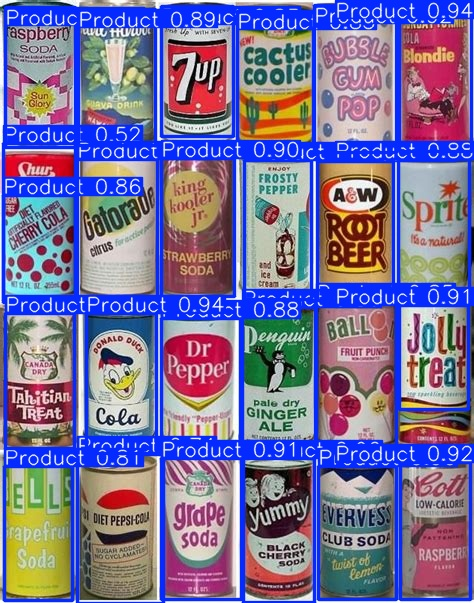

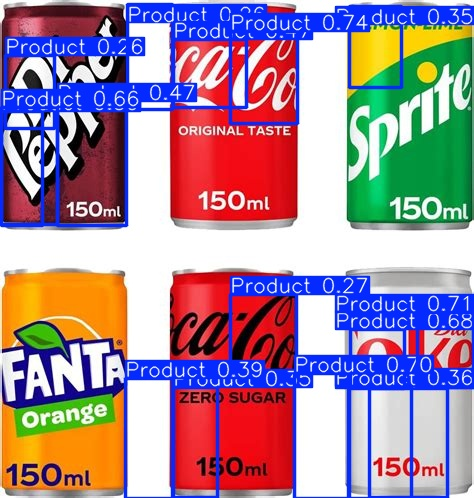

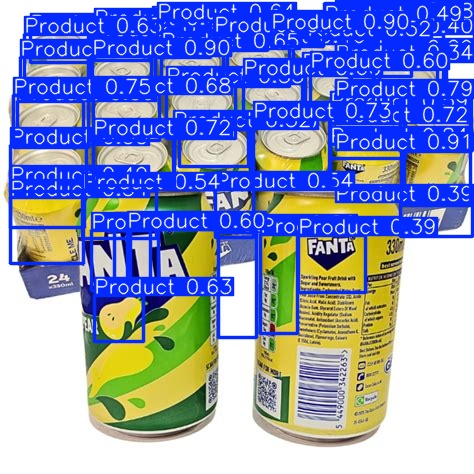

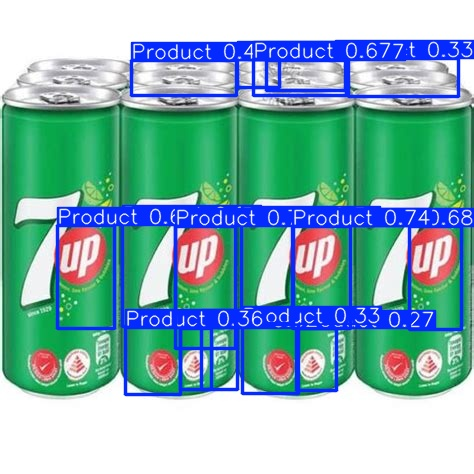

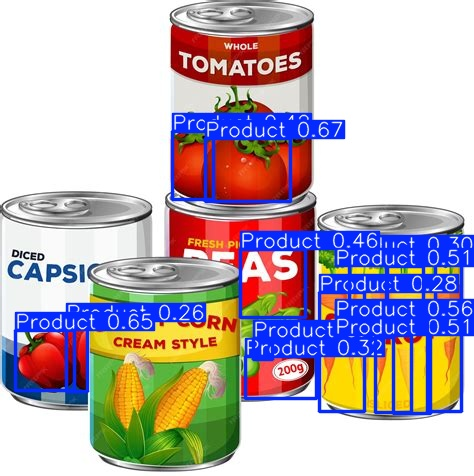

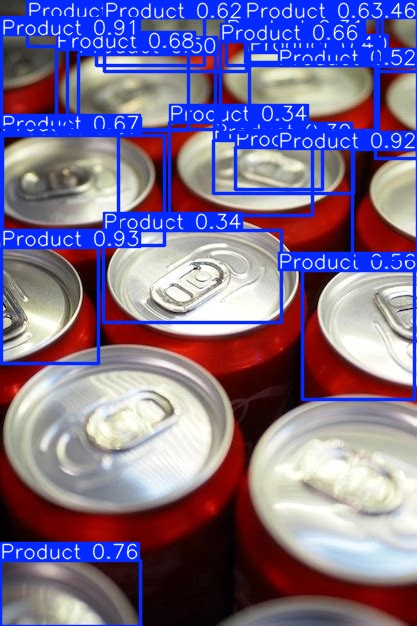

In [71]:
import os
from IPython.display import Image, display

output_folder = '/content/runs/detect/predict2'

for img in os.listdir(output_folder):
    if img.startswith(('iu_')):
        display(Image(os.path.join(output_folder, img)))



In [72]:
from google.colab import files
files.download('/content/runs/detect/train/weights/best.pt')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>